In [1]:
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
import scanpy as sc
import anndata
import os
import sys

In [2]:
sys.path.insert(1, '/secure/projects/tacco/')
import tacco as tc

In [3]:
sys.path.insert(1, '/secure/projects/HTAPP_MBC/src/spatial')
from spatial_utils import *

In [4]:
matplotlib.rcParams['figure.dpi'] = low_dpi

In [5]:
combined_dir=out_dir_base+"/combined_merfish/"
os.makedirs(combined_dir, exist_ok=True)

In [6]:
sample_sheet=pd.read_csv(codeDir+"/meta/sampletracking_HTAPP_MBC_spatial.csv")

In [7]:
#These identifiers are set as defaults in many functions. If names are changed, this has to be adapted when calling the functions.
ct_column='cell_type'
sm_methods=["slide_seq","merfish","merfish_bin","codex","exseq","exseq_bin"] #spatial mathod names are hard-coded for now because some methods need special treatments. Can be fixed by giving eatch method it's own variable.
sc_method="scRNAseq"
all_methods=[sc_method,*sm_methods]
all_methods

['scRNAseq',
 'slide_seq',
 'merfish',
 'merfish_bin',
 'codex',
 'exseq',
 'exseq_bin']

In [8]:
run_samples=list(filter(lambda a: not a in [''], list(sample_sheet['sample'].unique()))) 
run_samples

['HTAPP-944-SMP-7479',
 'HTAPP-895-SMP-7359',
 'HTAPP-880-SMP-7179',
 'HTAPP-878-SMP-7149',
 'HTAPP-812-SMP-8239',
 'HTAPP-514-SMP-6760',
 'HTAPP-982-SMP-7629',
 'HTAPP-997-SMP-7789',
 'HTAPP-917-SMP-4531',
 'HTAPP-853-SMP-4381',
 'HTAPP-313-SMP-932',
 'HTAPP-330-SMP-1082',
 'HTAPP-783-SMP-4081',
 'HTAPP-364-SMP-1321',
 'HTAPP-213-SMP-6752']

In [9]:
sel_methods=['scRNAseq','merfish']

### Only Execute first time (generates combined object)

In [10]:
adatas_combined=pd.Series([[] for i in range(len(sel_methods))],index=sel_methods,dtype=object) 
samples_combined=pd.Series([[] for i in range(len(sel_methods))],index=sel_methods,dtype=object) 
samples=[]
for sample in run_samples:
    print(sample)
    out_dir=out_dir_base+sample 
    adatas=get_and_process_data(sample,data_dir,out_dir,methods=sel_methods,process=False)
    for method in adatas.index:
        samples_combined[method].append(sample)
        adatas_combined[method].append(tc.get.counts(adatas[method],counts_location=('obsm','counts'),annotation=['replicate','cell_type','RCTD','OT','OT_max','x','y']))
        
for method in adatas_combined.index:
    adatas_combined[method]=create_scanpy(adatas_combined[method],replicates=samples_combined[method],var_genes=None,batch_key='sample',redo=False,process=True,mode=None)

HTAPP-944-SMP-7479
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-895-SMP-7359
reading  scRNAseq  from buffer
No data for merfish
HTAPP-880-SMP-7179
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-878-SMP-7149
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-812-SMP-8239
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-514-SMP-6760
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-982-SMP-7629
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-997-SMP-7789
reading  scRNAseq  from buffer
No data for merfish
HTAPP-917-SMP-4531
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-853-SMP-4381
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-313-SMP-932
reading  scRNAseq  from buffer
reading  merfish  from buffer
HTAPP-330-SMP-1082
reading  scRNAseq  from buffer
No data for merfish
HTAPP-783-SMP-4081
reading  scRNAseq  from buffer
No data for merfish
H

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1210: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'replicate' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cell_type' as categorical
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1210: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'replicate' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'RCTD' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'OT' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'OT_max' as categorical


In [33]:
adatas_combined['merfish'].obsm['RCTD'].fillna(0,inplace=True)
adatas_combined['merfish'].obsm['OT'].fillna(0,inplace=True)
adatas_combined['merfish'].obsm['OT_max'].fillna(0,inplace=True)

In [34]:
typing_to_obs(adatas_combined['merfish'],['RCTD','OT','OT_max'])

#### Annotate MERFISH by cluster

... storing 'RCTD' as categorical
... storing 'OT' as categorical
... storing 'OT_max' as categorical


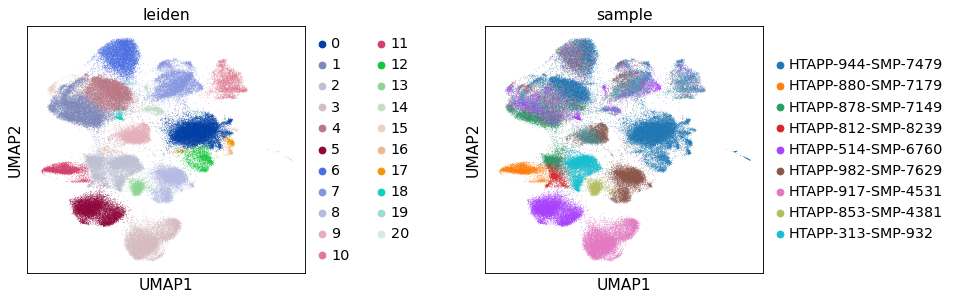

In [12]:
sc.pl.umap(adatas_combined['merfish'],color=['leiden','sample'],wspace=0.5)

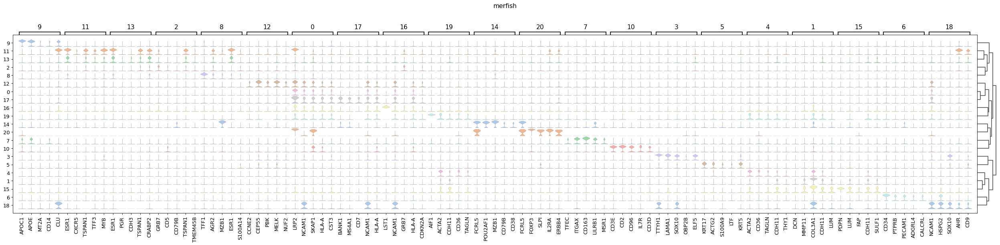

In [13]:
get_sub_markers(adatas_combined,methods=['merfish'],rest_thres=0.1)

In [14]:
cluster_annots=pd.Series(dtype=object)
cluster_annots['0']='MBC_neuronal'
cluster_annots['1']='Fibroblast'
cluster_annots['2']='MBC'
cluster_annots['3']='MBC'
cluster_annots['4']='Smooth muscle_vascular'
cluster_annots['5']='MBC'
cluster_annots['6']='Endothelial'
cluster_annots['7']='Macrophage'
cluster_annots['8']='MBC'
cluster_annots['9']='Hepatocyte'
cluster_annots['10']='T'
cluster_annots['11']='MBC'
cluster_annots['12']='MBC_neuronal'
cluster_annots['13']='MBC'
cluster_annots['14']='B'
cluster_annots['15']='Fibroblast'
cluster_annots['16']='MBC_neuronal'
cluster_annots['17']='MBC_neuronal'
cluster_annots['18']='Smooth muscle_vascular'
cluster_annots['19']='MBC_neuronal'
cluster_annots['20']='B_regulatory'

In [15]:
adatas_combined['merfish'].obs['cell_type']=adatas_combined['merfish'].obs['leiden'].map(cluster_annots)

In [55]:
adatas_combined['merfish'].write(combined_dir+"/merfish.h5ad",compression="gzip")

In [51]:
adatas_combined['scRNAseq'].write(combined_dir+"/scRNAseq.h5ad",compression="gzip")

### Analysis of combined object produced above

In [10]:
adatas_combined=pd.Series([[] for i in range(len(sel_methods))],index=sel_methods,dtype=object) 
adatas_combined['merfish']=sc.read_h5ad(combined_dir+"/merfish.h5ad")
adatas_combined['scRNAseq']=sc.read_h5ad(combined_dir+"/scRNAseq.h5ad")

In [11]:
#add missing annotation features to saved adata
#step 1: load as above adding the features that are missing
#adatas_combined2=adatas_combined

In [49]:
#step2: load original data
#step 3: add anotations
#assert((adatas_combined['merfish'].obs.index==adatas_combined2['merfish'].obs.index).all())
#adatas_combined['merfish'].obs[['x','y']]=adatas_combined2['merfish'].obs[['x','y']]
#adatas_combined['merfish'].obs[['replicate']]=adatas_combined2['merfish'].obs[['replicate']]

#### Compare annotations

In [14]:
#set colors
sel_colors=colors[colors.index.isin(adatas_combined['merfish'].obsm['RCTD'].columns)]
sel_colors['B_regulatory']='#E0115F'
sel_colors=sel_colors.reindex(index=['MBC', 'MBC_stem-like', 'MBC_neuronal', 'Endothelial','Endothelial_sinusoidal', 'Endothelial_angiogenic','Endothelial_vascular', 
                                     'Fibroblast', 'Smooth muscle_vascular','Stellate', 'Hepatocyte', 'Macrophage', 'Monocyte', 'Mast', 'B_plasma','B_regulatory','B', 'T', 'NK'])

/secure/projects/tacco/tacco/plots/_plots.py:872: RuntimeWarning: invalid value encountered in true_divide
  weights = weights / weights.sum(axis=-1)[...,None]


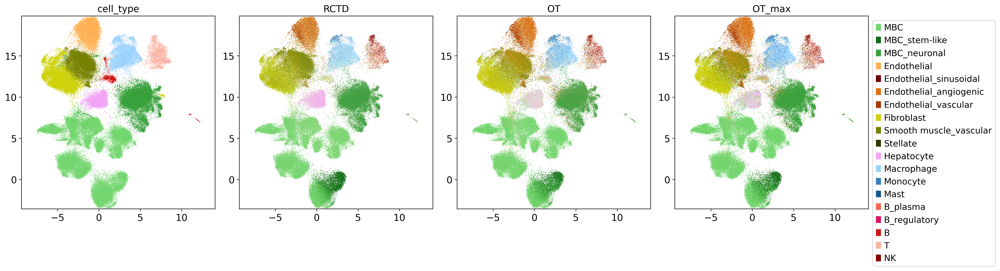

In [15]:
matplotlib.rcParams['figure.dpi'] = high_dpi
fig=tc.pl.scatter(adatas_combined['merfish'], keys=['cell_type','RCTD','OT',"OT_max"],colors=sel_colors,joint=True,axsize=(4,4),position_key="X_umap",point_size=0.5);
fig.savefig(f'{combined_dir}/UMAP_all_ct_annot.pdf',bbox_inches='tight')
matplotlib.rcParams['figure.dpi'] = low_dpi

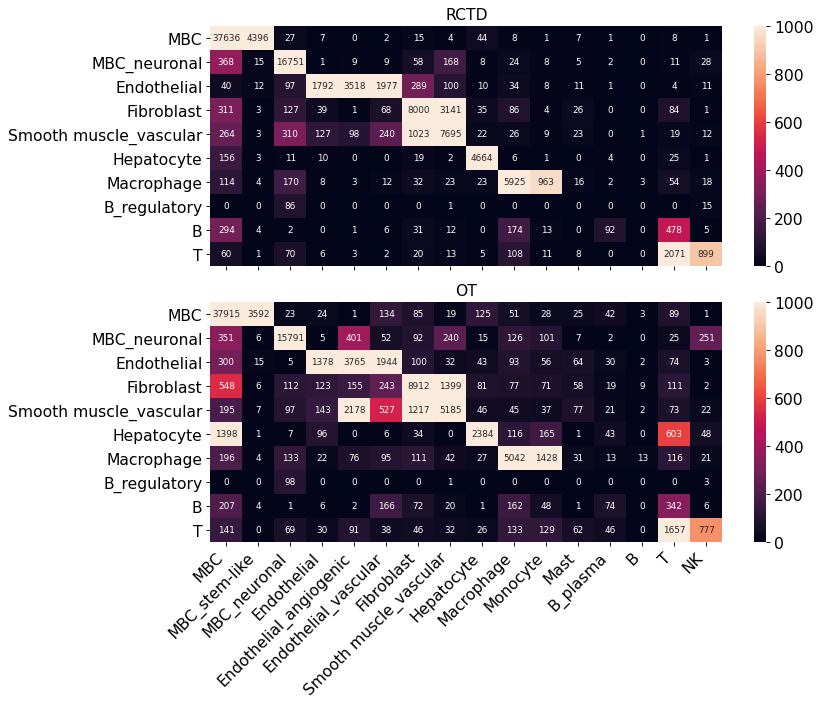

In [19]:
fig=plot_confusion(adatas_combined['merfish'],keys_1=['cell_type'],keys_2=['RCTD','OT'],sel_colors=sel_colors,)
fig.savefig(f'{combined_dir}/ct_annot_comp.pdf',bbox_inches='tight')

#### Define spatial bins

In [11]:
tc.utils.bin(adatas_combined['merfish'].obs,bin_size=100,bin_keys=["x_100","y_100"]);
tc.utils.hash(adatas_combined['merfish'].obs,keys=["x_100","y_100","sample"],hash_key=["bin_100"]);

#### Create cell type objects

In [12]:
lym_merfish=adatas_combined['merfish'][adatas_combined['merfish'].obs['cell_type'].isin(["T","NK"])].copy()
lym_sc=adatas_combined['scRNAseq'][adatas_combined['scRNAseq'].obs['cell_type'].isin(["T","NK"]) & adatas_combined['scRNAseq'].obs['sample'].isin(lym_merfish.obs['sample'])].copy()

In [13]:
mal_merfish=adatas_combined['merfish'][adatas_combined['merfish'].obs['cell_type'].isin(["MBC","MBC_neuronal"])].copy()
mal_sc=adatas_combined['scRNAseq'][adatas_combined['scRNAseq'].obs['cell_type'].isin(["MBC","MBC_neuronal","MBC_stem-like"]) & adatas_combined['scRNAseq'].obs['sample'].isin(mal_merfish.obs['sample'])].copy()

#### Add expression scores for freshand frozen EMT signature

In [14]:
pr_fresh=pd.read_csv(os.path.dirname(os.path.dirname(projectDir))+"/phase2/analysis/05_LIGER/compartments_fresh/Malignant_noRP_lambda_40_k_20_LIGER_topGenes.tsv",sep="\t")
pr_frozen=pd.read_csv(os.path.dirname(os.path.dirname(projectDir))+"/phase2/analysis/05_LIGER/compartments_frozen/Malignant_noRP_lambda_40_k_20_LIGER_topGenes.tsv",sep="\t")

In [15]:
sc.tl.score_genes(mal_merfish,gene_list=pr_fresh['Factor_16_u'],score_name="EMT_fresh",use_raw=True)
sc.tl.score_genes(mal_sc,gene_list=pr_fresh['Factor_16_u'],score_name="EMT_fresh",use_raw=True)

In [16]:
sc.tl.score_genes(mal_merfish,gene_list=pr_frozen['Factor_11_u'],score_name="EMT_frozen",use_raw=True)
sc.tl.score_genes(mal_sc,gene_list=pr_frozen['Factor_11_u'],score_name="EMT_frozen",use_raw=True)

In [ ]:
mal_merfish.obs.to_csv(combined_dir+"/merfish_mal_obs.tsv", sep="\t")
adatas_combined['merfish'].obs.to_csv(combined_dir+"/merfish_obs.tsv", sep="\t")
mal_merfish.write(combined_dir+"/merfish_mal.h5ad",compression="gzip")

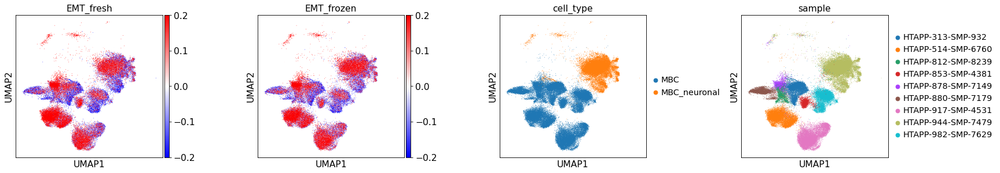

In [48]:
sc.pl.umap(mal_merfish,color=['EMT_fresh','EMT_frozen','cell_type','sample'],wspace=0.5,vmax=0.2,vmin=-0.2,cmap="bwr")

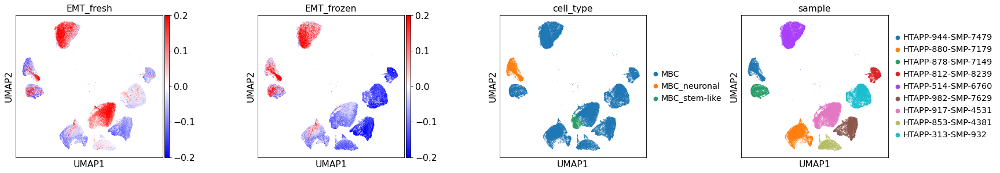

In [49]:
sc.pl.umap(mal_sc,color=['EMT_fresh','EMT_frozen','cell_type','sample'],wspace=0.5,vmax=0.2,vmin=-0.2,cmap="bwr")

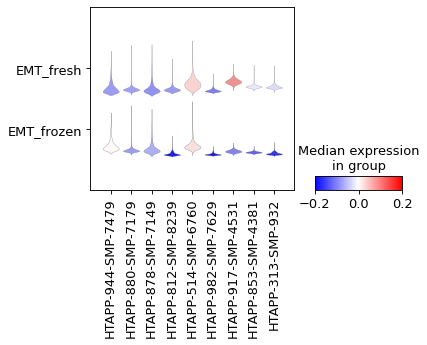

In [50]:
fig=sc.pl.stacked_violin(mal_sc,var_names=['EMT_fresh','EMT_frozen'],groupby='sample',rotation=90,swap_axes=True,
                         figsize=(5,3),cmap="bwr",vmax=0.2,vmin=-0.2,return_fig=True)
fig.savefig(f'{combined_dir}/sc_EMT_violin.pdf',bbox_inches='tight')

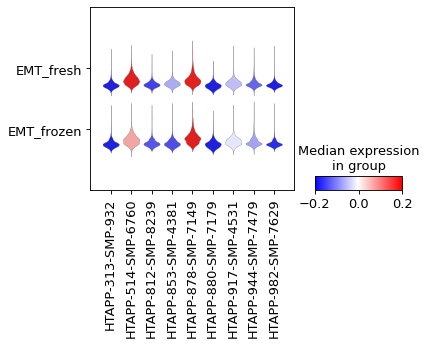

In [51]:
fig=sc.pl.stacked_violin(mal_merfish,var_names=['EMT_fresh','EMT_frozen'],groupby='sample',rotation=90,swap_axes=True,
                     figsize=(5,3),cmap="bwr",vmax=0.2,vmin=-0.2,return_fig=True)
fig.savefig(f'{combined_dir}/merfish_EMT_violin.pdf',bbox_inches='tight')

### Compare T/NK or EMT high vs low

In [17]:
scores_df=pd.DataFrame({"EMT_fresh":mal_merfish.obs.groupby(["bin_100","sample","replicate"])["EMT_fresh"].mean(),
                       "lym_cells":lym_merfish.obs.groupby(["bin_100","sample","replicate"]).size()}).reset_index()
scores_df.lym_cells.fillna(0,inplace=True)

In [18]:
new_obs=pd.merge(adatas_combined['merfish'].obs,scores_df,left_on=["sample","bin_100","replicate"],right_on=["sample","bin_100","replicate"],how="left")
adatas_combined['merfish'].obs=new_obs.set_index(adatas_combined['merfish'].obs.index)

#### EMT comparison

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


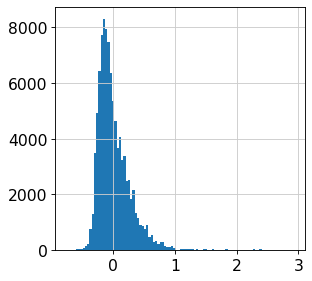

In [52]:
plt.hist(adatas_combined['merfish'].obs["EMT_fresh"],bins=100);

In [39]:
adatas_combined['merfish'].obs["EMT_prog_lo"]=adatas_combined['merfish'].obs["EMT_fresh"]<0

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'EMT_prog_lo' as categorical


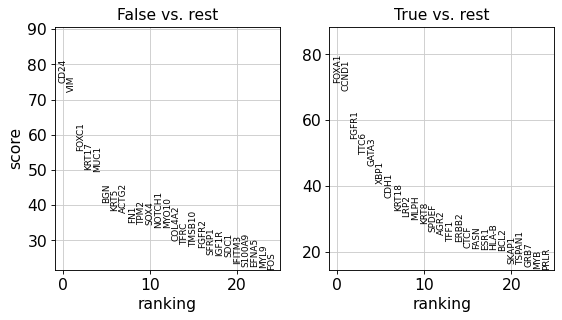

In [81]:
adata_de_mal=adatas_combined['merfish'][adatas_combined['merfish'].obs.cell_type.isin(["MBC","MBC_neuronal"])&(~adatas_combined['merfish'].obs["EMT_fresh"].isna())]
adata_de_mal.obs['EMT_prog_lo'] = adata_de_mal.obs['EMT_prog_lo'].astype("str")
sc.tl.rank_genes_groups(adata_de_mal, 'EMT_prog_lo', method='wilcoxon')
sc.pl.rank_genes_groups(adata_de_mal, n_genes=25, sharey=False)

lo=sc.get.rank_genes_groups_df(adata_de_mal,group=['True'],pval_cutoff=0.1,log2fc_min=0)
lo['direction']="EMT_lo"
hi=sc.get.rank_genes_groups_df(adata_de_mal,group=['False'],log2fc_min=0,pval_cutoff=0.1)
hi['direction']="EMT_hi"

de_genes_mal_EMT=pd.concat([lo,hi])
de_genes_mal_EMT.to_csv(combined_dir+"/de_genes_mal_EMT.tsv", sep="\t")

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'EMT_prog_lo' as categorical


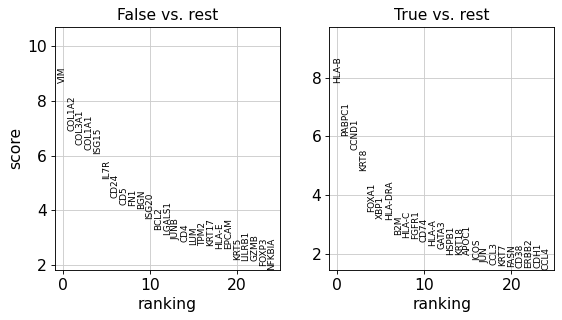

In [82]:
adata_de_lym=adatas_combined['merfish'][adatas_combined['merfish'].obs.cell_type.isin(["T","NK"])&(~adatas_combined['merfish'].obs["EMT_fresh"].isna())]
adata_de_lym.obs['EMT_prog_lo'] = adata_de_lym.obs['EMT_prog_lo'].astype("str")
sc.tl.rank_genes_groups(adata_de_lym, 'EMT_prog_lo', method='wilcoxon',)
sc.pl.rank_genes_groups(adata_de_lym, n_genes=25, sharey=False)
lo=sc.get.rank_genes_groups_df(adata_de_lym,group=['True'],pval_cutoff=0.1,log2fc_min=0)
lo['direction']="EMT_lo"
hi=sc.get.rank_genes_groups_df(adata_de_lym,group=['False'],log2fc_min=0,pval_cutoff=0.1)
hi['direction']="EMT_hi"

de_genes_lym_EMT=pd.concat([lo,hi])
de_genes_lym_EMT.to_csv(combined_dir+"/de_genes_lym_EMT.tsv", sep="\t")

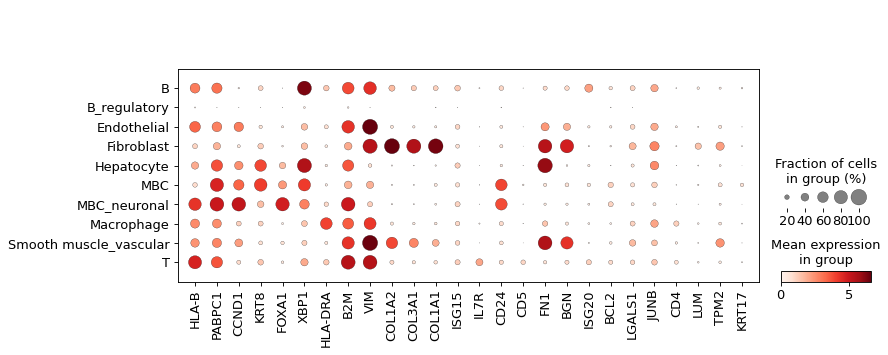

In [93]:
sc.pl.dotplot(adatas_combined['merfish'],var_names=de_genes_lym_EMT['names'],groupby="cell_type")

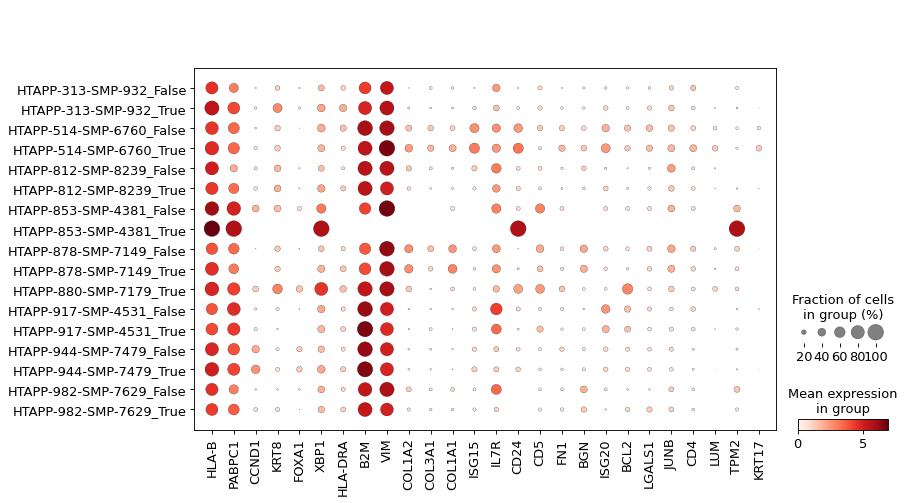

In [97]:
sc.pl.dotplot(adata_de_lym,var_names=de_genes_lym_EMT['names'],groupby=['sample',"EMT_prog_lo"])

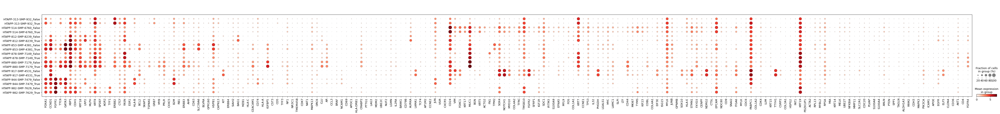

In [100]:
sc.pl.dotplot(adata_de_mal,var_names=de_genes_mal_EMT['names'],groupby=['sample',"EMT_prog_lo"])

In [104]:
matplotlib.rcParams['figure.dpi'] = high_dpi
adata_de_lym.obs['sample_repl']=adata_de_lym.obs["sample"].astype(str)+"_"+adata_de_lym.obs["replicate"].astype(str)
fig=tc.pl.scatter(adata_de_lym,group_key='sample_repl',keys=['EMT_prog_lo'],joint=True,padding=1.5,point_size=6,axsize=1e-3);
fig.savefig(f'{combined_dir}/scatter_EMT_lym.pdf',bbox_inches='tight')
matplotlib.rcParams['figure.dpi'] = low_dpi

/secure/projects/tacco/tacco/plots/_plots.py:872: RuntimeWarning: invalid value encountered in true_divide
  weights = weights / weights.sum(axis=-1)[...,None]


Trying to set attribute `.obs` of view, copying.
... storing 'EMT_prog_lo' as categorical


HTAPP-944-SMP-7479


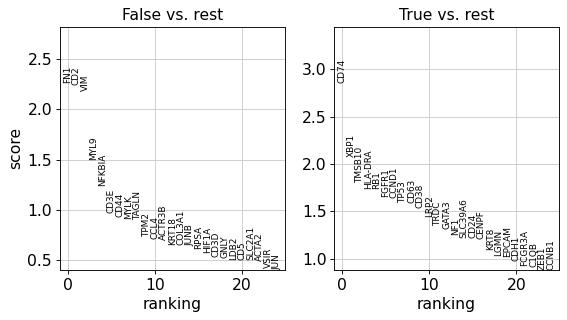

Trying to set attribute `.obs` of view, copying.
... storing 'EMT_prog_lo' as categorical


HTAPP-514-SMP-6760


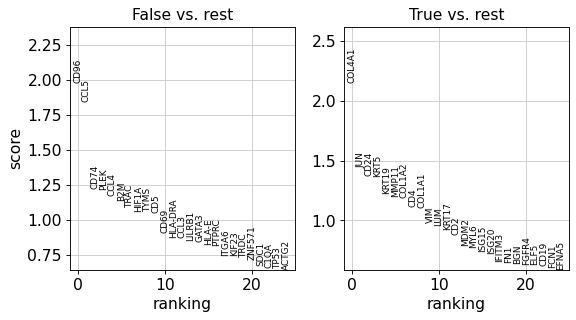

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
... storing 'EMT_prog_lo' as categorical


HTAPP-982-SMP-7629
HTAPP-917-SMP-4531
HTAPP-878-SMP-7149


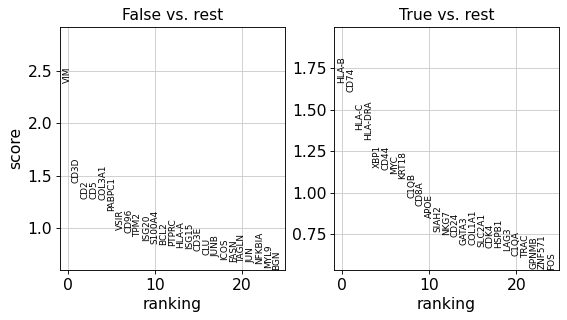

Trying to set attribute `.obs` of view, copying.
... storing 'EMT_prog_lo' as categorical


HTAPP-313-SMP-932


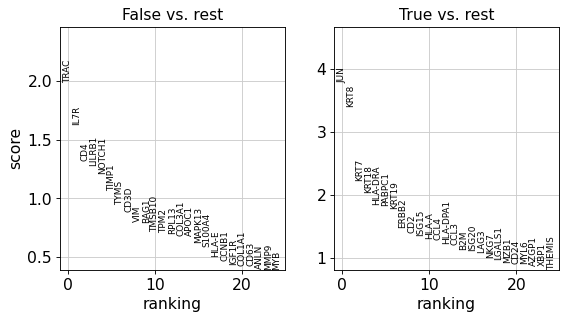

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
... storing 'EMT_prog_lo' as categorical


HTAPP-880-SMP-7179
HTAPP-812-SMP-8239


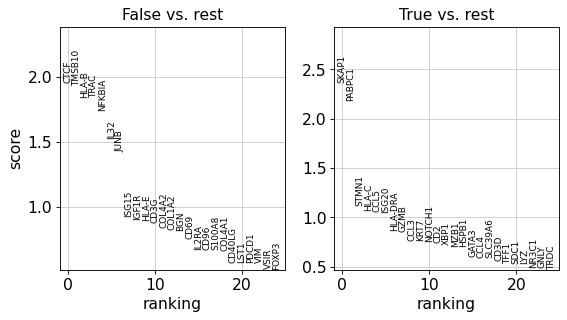

Trying to set attribute `.obs` of view, copying.


HTAPP-853-SMP-4381


In [107]:
for sample in adatas_combined['merfish'].obs['sample'].value_counts().index:
    adata_de=adatas_combined['merfish'][(adatas_combined['merfish'].obs.cell_type.isin(["T","NK"]))&
                                    (adatas_combined['merfish'].obs["sample"].isin([sample]))&(~adatas_combined['merfish'].obs["EMT_fresh"].isna())]
    adata_de.obs['EMT_prog_lo'] = adata_de.obs['EMT_prog_lo'].astype("str")
    print(sample)
    if adata_de.obs.shape[0]<100:
        continue
    sc.tl.rank_genes_groups(adata_de, 'EMT_prog_lo', method='wilcoxon')
    sc.pl.rank_genes_groups(adata_de, n_genes=25, sharey=False)

In [109]:
matplotlib.rcParams['figure.dpi'] = high_dpi
mal_merfish.obs['sample_repl']=mal_merfish.obs["sample"].astype(str)+"_"+mal_merfish.obs["replicate"].astype(str)
fig=tc.pl.scatter(mal_merfish,group_key='sample_repl',keys=['EMT_fresh'],cmap="bwr",cmap_vmin_vmax=[-1,1],joint=True,padding=1.5,point_size=2,axsize=1e-3);
fig.savefig(f'{combined_dir}/scatter_EMT_mal.pdf',bbox_inches='tight')
matplotlib.rcParams['figure.dpi'] = low_dpi

#### T/NK comparison

In [19]:
adatas_combined['merfish'].obs["lym_lo"]=adatas_combined['merfish'].obs["lym_cells"]<1

In [20]:
adatas_combined['merfish'].obs["lym_lo_samp"]=adatas_combined['merfish'].obs["sample"].isin(lym_merfish.obs.groupby(["sample"]).size()[lym_merfish.obs.groupby(["sample"]).size()<300].index.to_numpy())

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo_samp' as categorical


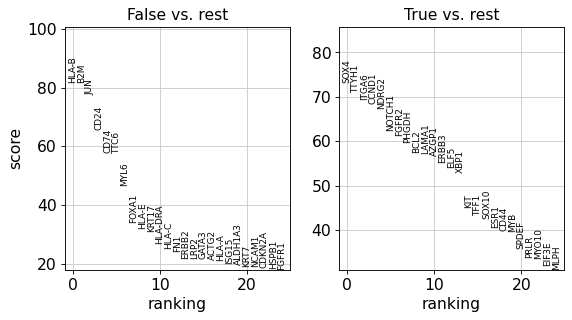

In [21]:
#sample-wise assignment to high or low lympho content
adata_de_lym_mal_smp=adatas_combined['merfish'][adatas_combined['merfish'].obs.cell_type.isin(["MBC","MBC_neuronal"])]
adata_de_lym_mal_smp.obs['lym_lo_samp'] = adata_de_lym_mal_smp.obs['lym_lo_samp'].astype("str")
sc.tl.rank_genes_groups(adata_de_lym_mal_smp, 'lym_lo_samp', method='wilcoxon')
sc.pl.rank_genes_groups(adata_de_lym_mal_smp, n_genes=25, sharey=False)

/secure/projects/tacco/tacco/plots/_plots.py:872: RuntimeWarning: invalid value encountered in true_divide
  weights = weights / weights.sum(axis=-1)[...,None]


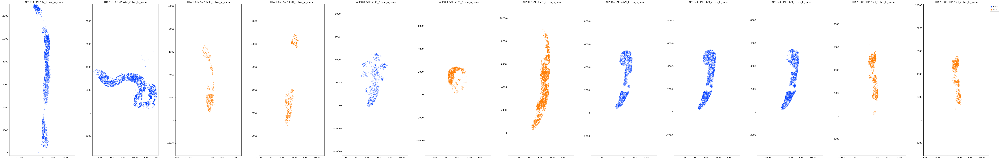

In [122]:
adata_de_lym_mal_smp.obs['sample_repl']=adata_de_lym_mal.obs["sample"].astype(str)+"_"+adata_de_lym_mal_smp.obs["replicate"].astype(str)
tc.pl.scatter(adata_de_lym_mal_smp,group_key='sample_repl',keys=['lym_lo_samp'],joint=True,padding=1.5,point_size=2,axsize=1e-3);

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


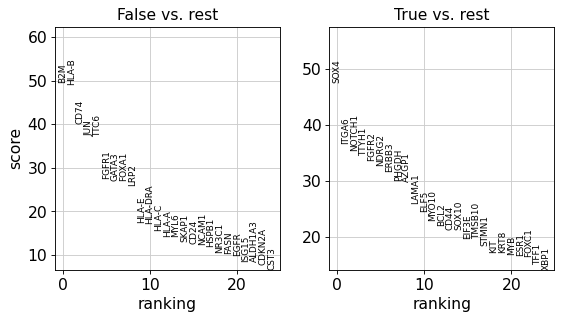

In [22]:
adata_de_lym_mal=adatas_combined['merfish'][adatas_combined['merfish'].obs.cell_type.isin(["MBC","MBC_neuronal"])]
adata_de_lym_mal.obs['lym_lo'] = adata_de_lym_mal.obs['lym_lo'].astype("str")
sc.tl.rank_genes_groups(adata_de_lym_mal, 'lym_lo', method='wilcoxon')
sc.pl.rank_genes_groups(adata_de_lym_mal, n_genes=25, sharey=False)

lo=sc.get.rank_genes_groups_df(adata_de_lym_mal,group=['True'],pval_cutoff=0.1,log2fc_min=0)
lo['direction']="Lym_lo"
hi=sc.get.rank_genes_groups_df(adata_de_lym_mal,group=['False'],log2fc_min=0,pval_cutoff=0.1)
hi['direction']="Lym_hi"

de_genes_mal_lym=pd.concat([lo,hi])
de_genes_mal_lym.to_csv(combined_dir+"/de_genes_mal_lym.tsv", sep="\t")

In [125]:
matplotlib.rcParams['figure.dpi'] = high_dpi
adata_de_lym_mal.obs['sample_repl']=adata_de_lym_mal.obs["sample"].astype(str)+"_"+adata_de_lym_mal.obs["replicate"].astype(str)
fig=tc.pl.scatter(adata_de_lym_mal,group_key='sample_repl',keys=['lym_lo'],joint=True,padding=1.5,point_size=2,axsize=1e-3);
fig.savefig(f'{combined_dir}/scatter_lym_mal.pdf',bbox_inches='tight')
matplotlib.rcParams['figure.dpi'] = low_dpi

/secure/projects/tacco/tacco/plots/_plots.py:872: RuntimeWarning: invalid value encountered in true_divide
  weights = weights / weights.sum(axis=-1)[...,None]


Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-944-SMP-7479


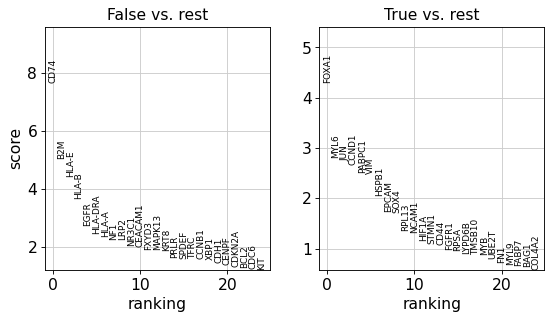

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-514-SMP-6760


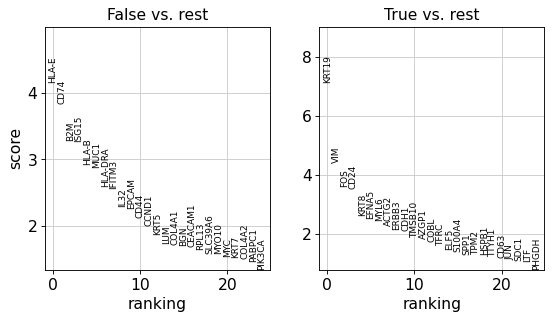

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-982-SMP-7629


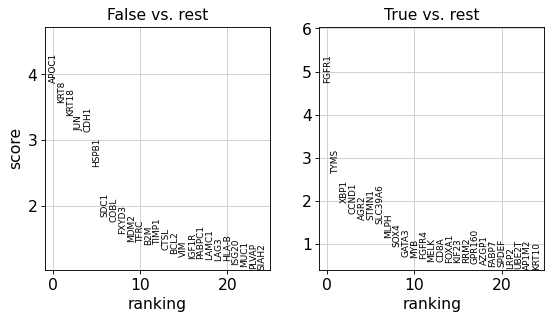

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-917-SMP-4531


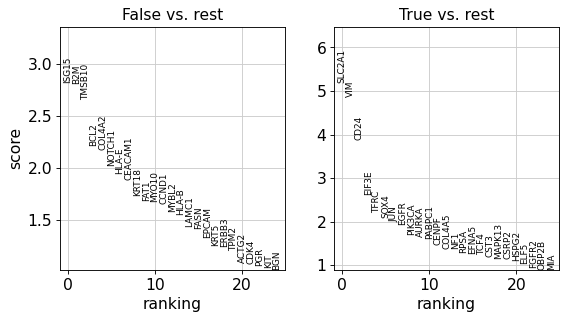

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-878-SMP-7149


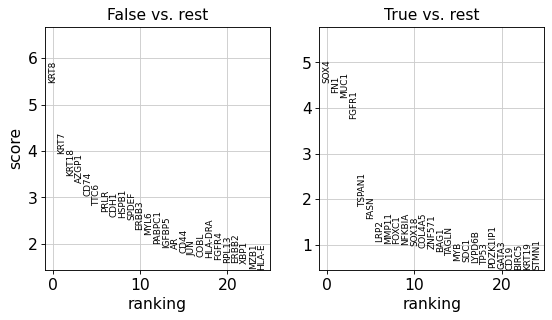

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-313-SMP-932


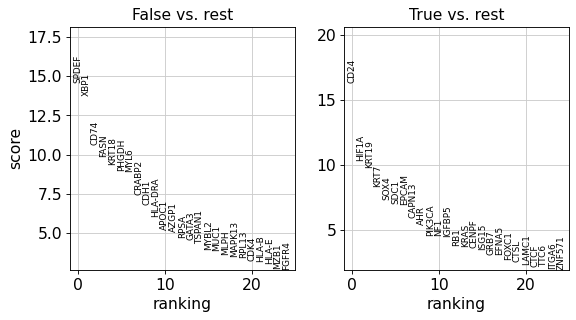

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-880-SMP-7179


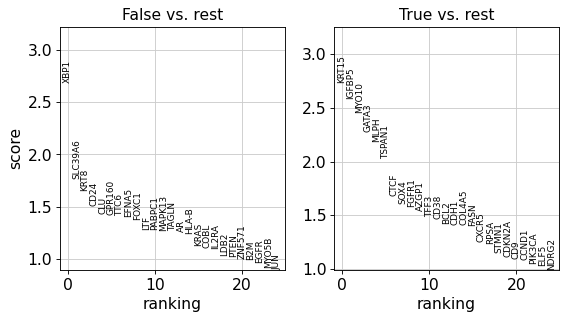

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-812-SMP-8239


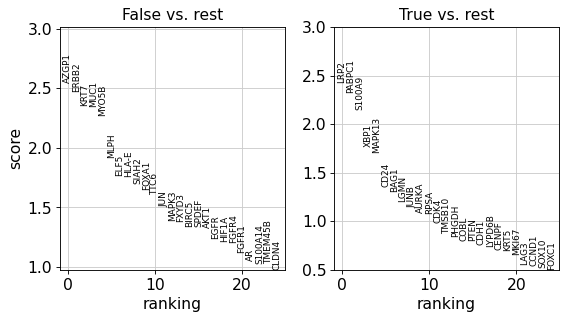

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
... storing 'replicate' as categorical
... storing 'lym_lo' as categorical


HTAPP-853-SMP-4381


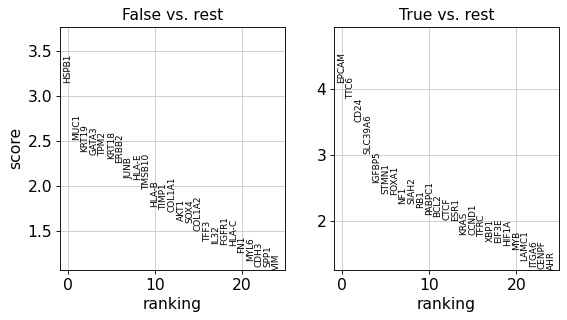

In [23]:
all_de=pd.DataFrame()
for sample in adatas_combined['merfish'].obs['sample'].value_counts().index:
    adata_de=adatas_combined['merfish'][(adatas_combined['merfish'].obs.cell_type.isin(["MBC","MBC_neuronal"]))&
                                    (adatas_combined['merfish'].obs["sample"].isin([sample]))]
    adata_de.obs['lym_lo'] = adata_de.obs['lym_lo'].astype("str")
    print(sample)
    sc.tl.rank_genes_groups(adata_de, 'lym_lo', method='wilcoxon')
    sc.pl.rank_genes_groups(adata_de, n_genes=25, sharey=False)
    
    lo=sc.get.rank_genes_groups_df(adata_de,group=['True'],pval_cutoff=None,log2fc_min=None)
    lo['direction']="Lym_lo"
    hi=sc.get.rank_genes_groups_df(adata_de,group=['False'],log2fc_min=None,pval_cutoff=None)
    hi['direction']="Lym_hi"
    tmp=pd.concat([lo,hi])
    tmp['sample']=sample
    all_de=pd.concat([all_de,tmp])
    
all_de.to_csv(combined_dir+"/de_genes_mal_lym_samplewise.tsv", sep="\t")

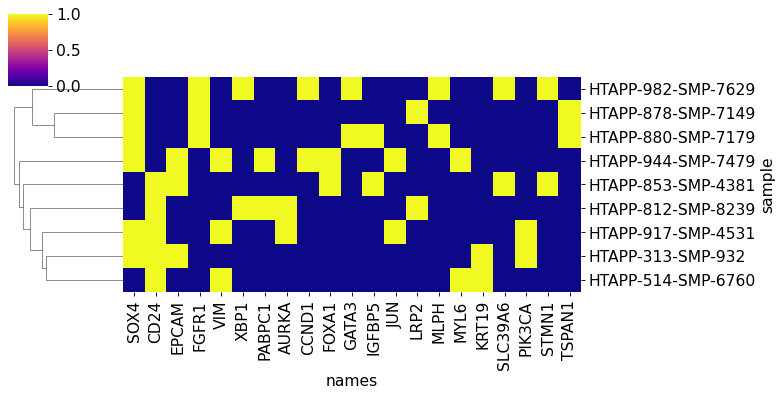

In [43]:
de_counts=all_de[(all_de.direction=='Lym_lo')&(all_de.index<10)].value_counts('names')
de_sub=all_de[(all_de.direction=='Lym_lo')&(all_de.index<10)].pivot(index='sample',columns='names',values='scores')[de_counts[de_counts>1].index]
de_sub.fillna(0,inplace=True)
de_sub[de_sub!=0]=1
fig=sns.clustermap(de_sub,figsize=(10, 5),col_cluster=False,row_cluster=True,cmap="plasma")
fig.savefig(f'{combined_dir}/hm_lo_lym_mal.pdf',bbox_inches='tight')

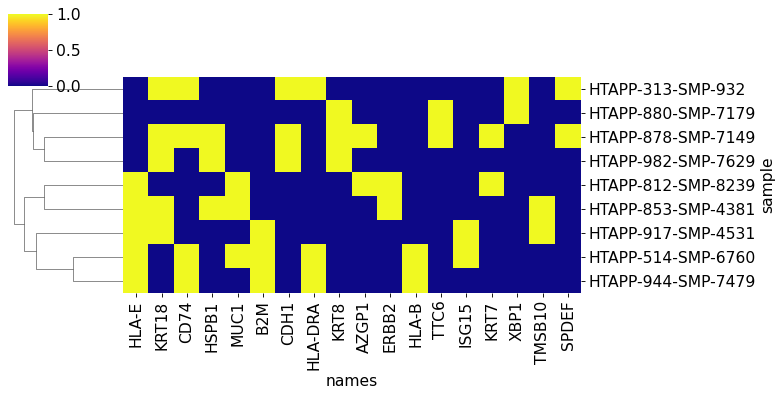

In [35]:
de_counts=all_de[(all_de.direction=='Lym_hi')&(all_de.index<10)].value_counts('names')
de_sub=all_de[(all_de.direction=='Lym_hi')&(all_de.index<10)].pivot(index='sample',columns='names',values='scores')[de_counts[de_counts>1].index]
de_sub.fillna(0,inplace=True)
de_sub[de_sub!=0]=1
fig=sns.clustermap(de_sub,figsize=(10, 5),col_cluster=False,row_cluster=True,cmap="plasma")
fig.savefig(f'{combined_dir}/hm_hi_lym_mal.pdf',bbox_inches='tight')

In [29]:
de_genes_mal_lym.loc[de_genes_mal_lym.direction=='Lym_hi','logfoldchanges']=-de_genes_mal_lym[de_genes_mal_lym.direction=='Lym_hi'].logfoldchanges

In [30]:
de_genes_mal_lym['nlog_pvals_adj']=-np.log10(de_genes_mal_lym.pvals_adj+(1E-300))

In [31]:
from plotnine import ggplot,aes,geom_point,geom_text, theme_bw

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 6.4 x 4.8 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/spatial//01_typing//combined_merfish//volcano_lym_mal.pdf


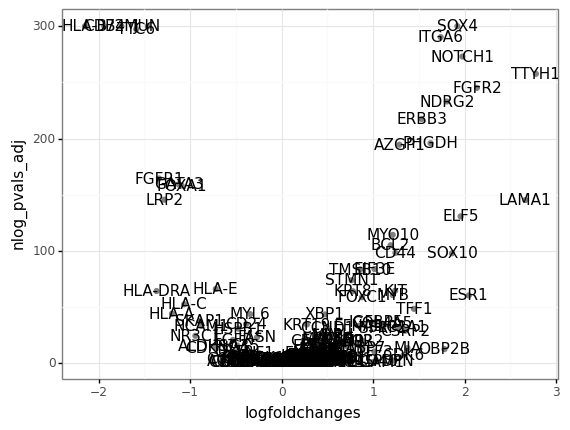

<ggplot: (-9223369088328362594)>

In [33]:
pl=(ggplot(de_genes_mal_lym,aes(x="logfoldchanges",y='nlog_pvals_adj'))+geom_point(color="grey")+geom_text(aes(label='names'))+theme_bw())
pl.save(f'{combined_dir}/volcano_lym_mal.pdf')
pl